In [1]:
import torch
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
from tqdm import tqdm

In [ ]:
!unzip TestDataSet.zip -d TestDataSet1

In [2]:
import os
import ast
import json
import requests
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import torchvision
from torchvision import models

# ── 1) Device & Model ─────────────────────────────────────────────────────────
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
weights = torchvision.models.ResNet34_Weights.IMAGENET1K_V1
model   = torchvision.models.resnet34(weights=weights).eval().to(device)

# ── 2) Load your subset’s labels.json ─────────────────────────────────────────
labels_path = "./TestDataSet1/labels_list.json"
with open(labels_path, "r") as f:
    entries = json.load(f)   # list of "401: accordion", …, "500: cliff dwelling"

# Extract the 100 global indices
global_idxs = [int(e.split(":", 1)[0]) for e in entries]

# ── 3) Download full ImageNet idx → synset mapping (Python‐dict repr) ─────────
URL = (
    "https://gist.githubusercontent.com/fnielsen/"
    "4a5c94eaa6dcdf29b7a62d886f540372/raw/"
    "imagenet_label_to_wordnet_synset.txt"
)
resp = requests.get(URL)

# Parse the Python dict string safely
synset_map = ast.literal_eval(resp.text)

# Build full idx→WNID map: e.g. 401 → "n02672831"
idx2wnid = {}
for k, info in synset_map.items():
    idx = int(k)
    # info['id'] is like "02672831-n", so split off "-n" and prefix "n"
    wn = info["id"].split("-", 1)[0]
    idx2wnid[idx] = "n" + wn

# Build the subset’s WNID→global index map
subset_wnid_to_global = {
    idx2wnid[idx]: idx
    for idx in global_idxs
}

# ── 4) Transforms ──────────────────────────────────────────────────────────────
mean = [0.485, 0.456, 0.406]
std  = [0.229, 0.224, 0.225]
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std)
])

root = "./TestDataSet1"

# ── 5) Filter out __MACOSX & .ipynb_checkpoints ───────────────────────────────
class FilteredImageFolder(ImageFolder):
    def find_classes(self, directory):
        valid = [
            d for d in os.listdir(directory)
            if os.path.isdir(os.path.join(directory, d))
            and d not in ("__MACOSX", ".ipynb_checkpoints")
        ]
        valid.sort()
        class_to_idx = {cls_name: i for i, cls_name in enumerate(valid)}
        return valid, class_to_idx

# Load images: base_ds.classes is your 100 WNIDs
base_ds = FilteredImageFolder(root, transform=transform)
print("WNID folders:", base_ds.classes[:5], "… total", len(base_ds.classes))

# ── 6) Map each folder index → global ImageNet index ──────────────────────────
folder2global = {
    folder_idx: subset_wnid_to_global[wnid]
    for folder_idx, wnid in enumerate(base_ds.classes)
}

# ── 7) Wrap to yield (image_tensor, global_idx) ───────────────────────────────
class SubsetDataset(Dataset):
    def __init__(self, base_ds, f2g):
        self.base = base_ds
        self.map  = f2g
    def __len__(self):
        return len(self.base)
    def __getitem__(self, idx):
        img, folder_idx = self.base[idx]
        return img, self.map[folder_idx]

ds     = SubsetDataset(base_ds, folder2global)
loader = DataLoader(ds, batch_size=64, shuffle=False, num_workers=4)

# ── 8) Sanity check ────────────────────────────────────────────────────────────
imgs, labels = next(iter(loader))
print("Batch shape:", imgs.shape)                 # [64,3,224,224]
print("Global labels:", labels[:8].tolist())      # e.g. [401,401,...,402,...]
print("All mapping correct:", set(labels.tolist()) <= set(global_idxs))

WNID folders: ['n02672831', 'n02676566', 'n02687172', 'n02690373', 'n02692877'] … total 100
Batch shape: torch.Size([64, 3, 224, 224])
Global labels: [401, 401, 401, 401, 401, 402, 402, 402]
All mapping correct: True


In [20]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import random

def verify_L_inf(path, loader, eps=0.02, mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225), num_samples=5):
    """
    1) Loads adversarial images from pt_path (expects a tuple (adv_imgs, adv_labels))
    2) Pulls the first adv_imgs.size(0) examples from orig_loader
    3) Verifies L_inf <= eps
    4) Plots num_samples random pairs for visual check
    """
    # Load adv set
    adv_imgs, adv_labels = torch.load(path)       # (N, C, H, W)
    N = adv_imgs.size(0)

    # Gather first N originals
    orig_list = []
    count = 0
    for imgs, _ in tqdm(loader):
        if count >= N:
            break
        take = min(imgs.size(0), N - count)
        orig_list.append(imgs[:take])
        count += take
    orig_imgs = torch.cat(orig_list, dim=0)[:N]

    # Compute per-image L_inf distances
    diff = (adv_imgs - orig_imgs).abs().view(N, -1).detach()      # detach here
    max_diff_per_img = diff.max(dim=1)[0].cpu().numpy()          # move to CPU then numpy()

    # Assert bound
    if not(np.all(max_diff_per_img <= eps + 1e-6)):
        print(f"⚠️ Some images exceed ε={eps}% max observed {max_diff_per_img.max():.4f} for path: {path}")
    else:
        print(f"✔️ All {N} adversarial samples respect L∞ ≤ {eps}")

    # Visual comparison
    inv_norm = lambda x: x.mul(torch.tensor(std)[:,None,None])\
                         .add_(torch.tensor(mean)[:,None,None])

    indices = random.sample(range(N), num_samples)
    fig, axes = plt.subplots(num_samples, 2, figsize=(6, 3*num_samples))
    for i, idx in enumerate(indices):
        orig = inv_norm(orig_imgs[idx]).permute(1,2,0).clamp(0,1).numpy()
        adv  = inv_norm(adv_imgs[idx]).permute(1,2,0).clamp(0,1).detach().numpy()

        axes[i,0].imshow(orig)
        axes[i,0].set_title(f"Orig #{idx}")
        axes[i,0].axis('off')

        axes[i,1].imshow(adv)
        axes[i,1].set_title(f"Adv #{idx} (L∞={max_diff_per_img[idx]:.4f})")
        axes[i,1].axis('off')

    plt.tight_layout()
    plt.show()

In [4]:
# ─────────────── 1) Top‑k Evaluation Function ────────────────
import torch
import torch.nn.functional as F
from tqdm import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

@torch.no_grad()
def evaluate(loader, model, ks=(1,5)):
    model.eval()
    total = {k: 0 for k in ks}
    correct = {k: 0 for k in ks}

    for imgs, labels in tqdm(loader, desc="Eval"):
        imgs, labels = imgs.to(device), labels.to(device)
        # forward
        logits = model(imgs)
        # top‑k preds
        vals, preds = logits.topk(max(ks), dim=1)

        for k in ks:
            total[k] += labels.size(0)
            # for each sample, did any of the top‑k match?
            correct_k = (preds[:, :k] == labels.unsqueeze(1)).any(dim=1).sum().item()
            correct[k] += correct_k

    return {k: correct[k]/total[k] for k in ks}

# Compute baseline on original
ks = (1,5)
baseline = evaluate(loader, model, ks=(1,5))
print(ks)
print(f"Baseline Top‑1: {baseline[1]*100:.2f}%, Top‑5: {baseline[5]*100:.2f}%")

Eval: 100%|██████████| 8/8 [00:00<00:00,  9.73it/s]

(1, 5)
Baseline Top‑1: 76.00%, Top‑5: 94.20%


In [5]:
# ─────────────── 2) FGSM Attack (ε=0.02) ────────────────
def fgsm_attack(x, y, model, eps=0.02, mean=None, std=None, device='cuda'):
    x = x.to(device).detach()
    y = y.to(device)

    x.requires_grad = True
    logits = model(x)
    loss = F.cross_entropy(logits, y)
    loss.backward()

    grad_sign = x.grad.data.sign()
    x_adv = x + eps * grad_sign

    # Normalize limits
    mean = torch.tensor(mean, device=device)[:, None, None]
    std = torch.tensor(std, device=device)[:, None, None]
    min_val = (0.0 - mean) / std
    max_val = (1.0 - mean) / std

    x_adv = torch.max(torch.min(x_adv, max_val), min_val)
    return x_adv.detach()
    
# generate adversarial examples
from tqdm import tqdm

adv_imgs, adv_labels = [], []
total_needed = 500
count = 0

for imgs, labels in tqdm(loader, desc="FGSM gen"):
    if count >= total_needed:
        break
    if count + imgs.size(0) > total_needed:
        imgs = imgs[:total_needed - count]
        labels = labels[:total_needed - count]

    adv = fgsm_attack(imgs, labels, model, eps=0.02, mean=mean, std=std, device=device)
    adv_imgs.append(adv.cpu())
    adv_labels.append(labels)

    count += adv.size(0)

adv_imgs = torch.cat(adv_imgs)
adv_labels = torch.cat(adv_labels)

torch.save((adv_imgs, adv_labels), 'adv_test_set1.pt')
print("✅ Saved Adversarial Test Set 1 → adv_test_set1.pt")

# wrap into DataLoader
adv_ds = TensorDataset(adv_imgs, adv_labels)
adv_loader = DataLoader(adv_ds, batch_size=64, shuffle=False, num_workers=4)

acc = evaluate(adv_loader, model, ks=(1, 5))
print(f"📉 FGSM Adversarial — Top-1: {acc[1]*100:.2f}%, Top-5: {acc[5]*100:.2f}%")

FGSM gen: 100%|██████████| 8/8 [00:01<00:00,  7.91it/s]


✅ Saved Adversarial Test Set 1 → adv_test_set1.pt


Eval: 100%|██████████| 8/8 [00:00<00:00, 24.31it/s]

📉 FGSM Adversarial — Top-1: 6.00%, Top-5: 35.60%


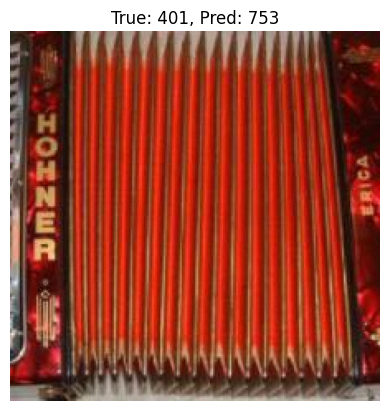

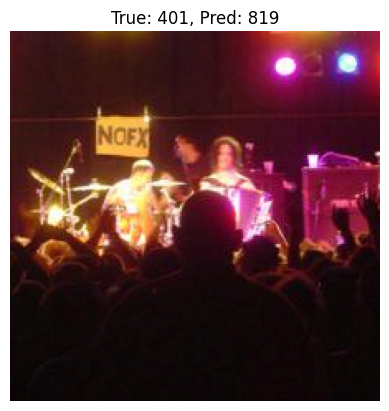

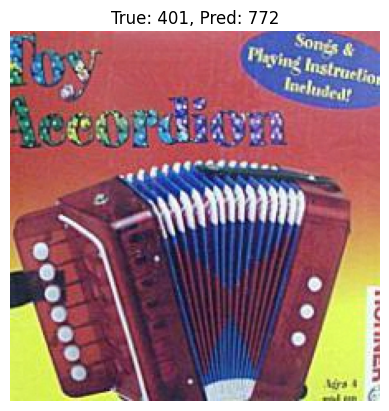

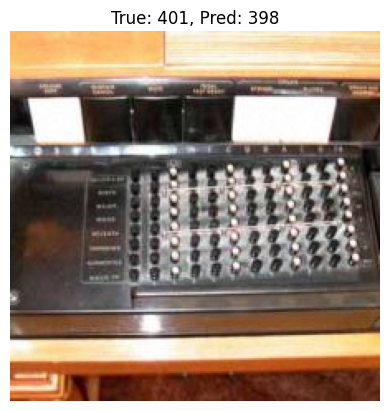

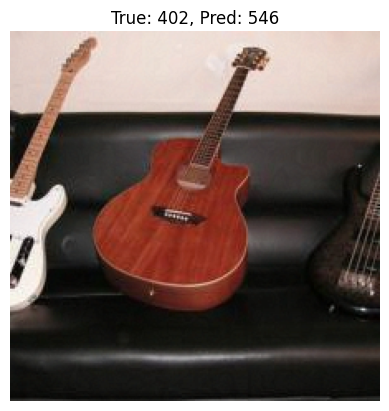

In [6]:
import matplotlib.pyplot as plt
import torchvision.transforms as T

inv_normalize = T.Normalize(
    mean=[-m/s for m, s in zip(mean, std)],
    std=[1/s for s in std]
)

model.eval()
shown = 0
for i in range(len(adv_imgs)):
    img = adv_imgs[i].unsqueeze(0).to(device)
    label = adv_labels[i].item()
    pred = model(img).argmax(dim=1).item()
    if pred != label:
        denorm_img = inv_normalize(adv_imgs[i]).clamp(0,1).permute(1,2,0).numpy()
        plt.imshow(denorm_img)
        plt.title(f"True: {label}, Pred: {pred}")
        plt.axis('off')
        plt.show()
        shown += 1
    if shown >= 5:
        break

In [7]:
import torch
import torch.nn.functional as F

def pgd_attack(x, y, model, eps=0.02, alpha=0.005, iters=10):
    x_adv = x.clone().detach().to(device)
    # random start within ε‐ball
    x_adv = x_adv + torch.empty_like(x_adv).uniform_(-eps, eps).to(device)
    x_adv.requires_grad_(True)

    min_val = (0.0 - torch.tensor(mean)[:,None,None]) / torch.tensor(std)[:,None,None]
    max_val = (1.0 - torch.tensor(mean)[:,None,None]) / torch.tensor(std)[:,None,None]

    for _ in range(iters):
        logits = model(x_adv)
        loss = F.cross_entropy(logits, y.to(device))
        loss.backward()
        # step & project back
        x_adv = x_adv + alpha * x_adv.grad.sign()
        delta = torch.clamp(x_adv - x.to(device), min=-eps, max=+eps)
        x_adv = torch.clamp(x.to(device) + delta, min_val.to(device), max_val.to(device)).detach()
        x_adv.requires_grad_(True)
    return x_adv

from torch.utils.data import TensorDataset, DataLoader
from tqdm import tqdm

# Generate adversarial set of size 500
adv_imgs, adv_labels = [], []
total = 500
count = 0

for imgs, labels in tqdm(loader, desc="PGD gen"):
    if count >= total:
        break
    if count + imgs.size(0) > total:
        imgs, labels = imgs[:total-count], labels[:total-count]

    adv_batch = pgd_attack(imgs, labels, model,
                           eps=0.02, alpha=0.005, iters=10)
    adv_imgs.append(adv_batch.cpu())
    adv_labels.append(labels)
    count += adv_batch.size(0)

adv_imgs = torch.cat(adv_imgs)
adv_labels = torch.cat(adv_labels)

# Save dataset
torch.save((adv_imgs, adv_labels), 'adv_test_set2.pt')

# Evaluate
adv_ds     = TensorDataset(adv_imgs, adv_labels)
adv2_loader = DataLoader(adv_ds, batch_size=64, shuffle=False, num_workers=4)
acc = evaluate(adv2_loader, model, ks=(1,5))
print(f"PGD Top-1: {acc[1]*100:.2f}%, Top-5: {acc[5]*100:.2f}%")

Eval: 100%|██████████| 8/8 [00:00<00:00, 23.59it/s]

PGD Top-1: 0.00%, Top-5: 11.60%


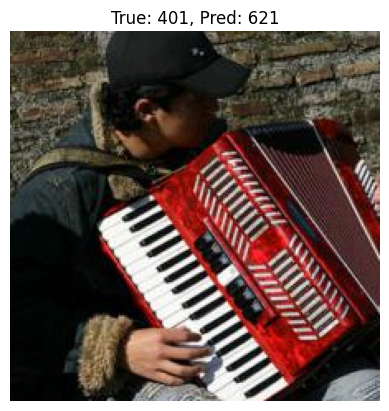

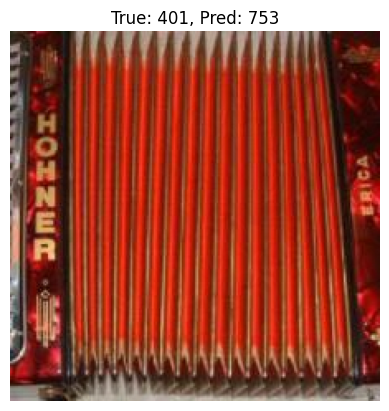

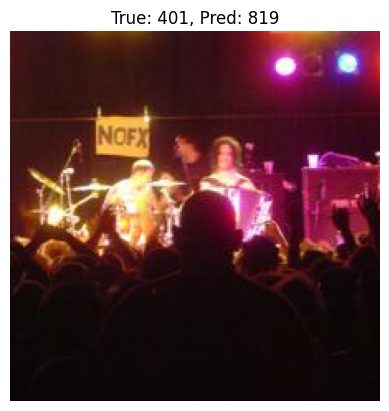

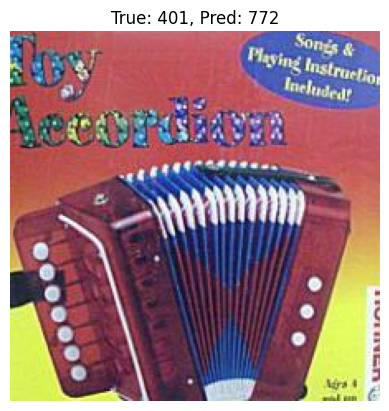

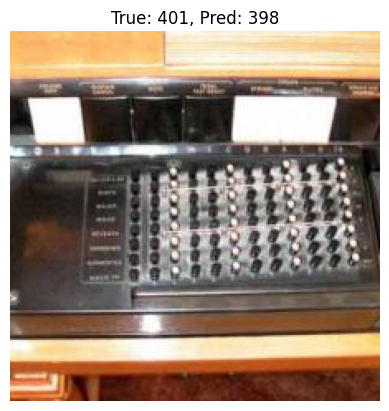

In [8]:
import matplotlib.pyplot as plt
import torchvision.transforms as T

inv_normalize = T.Normalize(
    mean=[-m/s for m, s in zip(mean, std)],
    std=[1/s for s in std]
)

model.eval()
shown = 0
for i in range(len(adv_imgs)):
    img = adv_imgs[i].unsqueeze(0).to(device)
    label = adv_labels[i].item()
    pred = model(img).argmax(dim=1).item()
    if pred != label:
        denorm_img = inv_normalize(adv_imgs[i]).clamp(0,1).permute(1,2,0).detach().numpy()
        plt.imshow(denorm_img)
        plt.title(f"True: {label}, Pred: {pred}")
        plt.axis('off')
        plt.show()
        shown += 1
    if shown >= 5:
        break

In [9]:
import torch
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
from tqdm import tqdm

def multi_patch32_pgd_attack(
    x, y, model,
    patch_size=32,      # fixed
    num_patches=6,      # cover more area via 6 patches
    eps=0.5,            # full normalized budget
    alpha=0.08,         # step size
    iters=80,           # iterations per restart
    restarts=8,         # random restarts
    momentum=0.9,
    mean=(0.485,0.456,0.406),
    std=(0.229,0.224,0.225),
    device='cuda'
):
    model.eval()
    b, c, H, W = x.shape

    # precompute clamps
    mean_t = torch.tensor(mean, device=device)[:,None,None]
    std_t  = torch.tensor(std,  device=device)[:,None,None]
    min_val = (0.0 - mean_t) / std_t
    max_val = (1.0 - mean_t) / std_t

    x_nat = x.to(device)
    with torch.no_grad():
        logits0 = model(x_nat)
        _, sorted_idx = logits0.sort(dim=1, descending=False)
        targets = sorted_idx[:, 1]   # second‐least likely

    best_adv  = x_nat.clone()
    best_loss = torch.full((b,), float('inf'), device=device)

    for _ in range(restarts):
        delta = torch.zeros_like(x_nat).uniform_(-eps, eps).to(device).requires_grad_(True)
        v     = torch.zeros_like(delta)

        for _ in range(iters):
            # build mask with multiple 32×32 patches
            mask = torch.zeros_like(x_nat)
            for i in range(b):
                for _p in range(num_patches):
                    top  = torch.randint(0, H-patch_size+1, (1,), device=device).item()
                    left = torch.randint(0, W-patch_size+1, (1,), device=device).item()
                    mask[i, :, top:top+patch_size, left:left+patch_size] = 1.0

            adv   = torch.clamp(x_nat + delta * mask, min_val, max_val)
            logits= model(adv)
            loss  = F.cross_entropy(logits, targets, reduction='sum')
            grads = torch.autograd.grad(loss, delta)[0]

            # normalize & momentum update
            denom = grads.abs().view(b, -1).mean(dim=1).view(b,1,1,1).clamp(min=1e-8)
            g_norm= grads / denom
            v     = momentum * v + g_norm

            delta.data = (delta - alpha * v.sign() * mask).clamp(-eps, eps)
            delta.grad = None

        # evaluate this restart
        with torch.no_grad():
            adv_final = torch.clamp(x_nat + delta * mask, min_val, max_val)
            losses   = F.cross_entropy(model(adv_final), targets, reduction='none')
            better   = losses < best_loss
            best_loss[better] = losses[better]
            best_adv[better]  = adv_final[better]

    return best_adv.detach()


# ─── Build Adversarial Test Set 3 (Patch‐size=32) ────────────────────────────
adv3_imgs, adv3_labels = [], []
need, count = 500, 0

for imgs, labels in tqdm(loader, desc="Building Adv Set 3 (32×32)"):
    if count >= need:
        break
    if count + imgs.size(0) > need:
        imgs, labels = imgs[:need-count], labels[:need-count]

    adv_batch = multi_patch32_pgd_attack(
        imgs, labels, model,
        patch_size=32,      # fixed 32×32
        num_patches=6,
        eps=1.0,
        alpha=0.08,
        iters=80,
        restarts=8,
        momentum=0.9,
        mean=mean,
        std=std,
        device=device
    )
    adv3_imgs.append(adv_batch.cpu())
    adv3_labels.append(labels)
    count += adv_batch.size(0)

adv3_imgs   = torch.cat(adv3_imgs)
adv3_labels = torch.cat(adv3_labels)
torch.save((adv3_imgs, adv3_labels), 'adv_test_set3.pt')
print("✅ Saved Adversarial Test Set 3 → adv_test_set3.pt")

# ─── Evaluate ────────────────────────────────────────────────────────────────
adv3_ds     = TensorDataset(adv3_imgs, adv3_labels)
adv3_loader = DataLoader(adv3_ds, batch_size=64, shuffle=False, num_workers=4)
acc3        = evaluate(adv3_loader, model, ks=(1,5))
print(f"🚨 Patch32×32 PGD — Top-1: {acc3[1]*100:.2f}%, Top-5: {acc3[5]*100:.2f}%")

Building Adv Set 3 (32×32): 100%|██████████| 8/8 [04:52<00:00, 36.56s/it]


✅ Saved Adversarial Test Set 3 → adv_test_set3.pt


Eval: 100%|██████████| 8/8 [00:00<00:00, 23.71it/s]

🚨 Patch32×32 PGD — Top-1: 19.40%, Top-5: 45.00%


In [13]:
# ─── Attack Definition ─────────────────────────────────────────────────────────
def powerful_targeted_patch_attack(
    x, y, model,
    patch_size=32,
    eps=0.5,
    iters=150,
    alpha=None,
    restarts=5,
    momentum=0.9,
    location_jump=10,
    device='cuda'
):
    model.eval()
    b, c, h, w = x.shape
    alpha = eps / iters if alpha is None else alpha

    mean_t = torch.tensor(mean, device=device)[:, None, None]
    std_t  = torch.tensor(std, device=device)[:, None, None]
    min_val = (0.0 - mean_t) / std_t
    max_val = (1.0 - mean_t) / std_t

    x_nat = x.to(device)
    with torch.no_grad():
        logits = model(x_nat)
        targets = logits.argmin(dim=1)

    best_adv = x_nat.clone()
    best_loss = torch.full((b,), float('inf'), device=device)

    for _ in range(restarts):
        delta = torch.zeros_like(x_nat).uniform_(-eps, eps).to(device).requires_grad_(True)
        momentum_buffer = torch.zeros_like(delta)

        # initialize patch mask
        tops = torch.randint(0, h - patch_size + 1, (b,), device=device)
        lefts = torch.randint(0, w - patch_size + 1, (b,), device=device)
        mask = torch.zeros_like(x_nat)
        for i in range(b):
            t, l = tops[i], lefts[i]
            mask[i, :, t:t+patch_size, l:l+patch_size] = 1.0

        for i in range(iters):
            if i % location_jump == 0 and i > 0:
                # Re-randomize patch location to escape local minima
                tops = torch.randint(0, h - patch_size + 1, (b,), device=device)
                lefts = torch.randint(0, w - patch_size + 1, (b,), device=device)
                mask = torch.zeros_like(x_nat)
                for idx in range(b):
                    t, l = tops[idx], lefts[idx]
                    mask[idx, :, t:t+patch_size, l:l+patch_size] = 1.0

            adv = torch.clamp(x_nat + delta * mask, min_val, max_val)
            logits = model(adv)
            loss = F.cross_entropy(logits, targets, reduction='sum')

            grad = torch.autograd.grad(loss, delta, retain_graph=False, create_graph=False)[0]

            grad_norm = grad.abs().view(b, -1).mean(dim=1).view(b, 1, 1, 1).clamp(min=1e-8)
            normed_grad = grad / grad_norm

            momentum_buffer = momentum * momentum_buffer + normed_grad

            delta.data = (delta - alpha * momentum_buffer.sign() * mask).clamp(-eps, eps)
            delta.grad = None

        with torch.no_grad():
            adv_final = torch.clamp(x_nat + delta * mask, min_val, max_val)
            logits = model(adv_final)
            losses = F.cross_entropy(logits, targets, reduction='none')
            better = losses < best_loss
            best_loss[better] = losses[better]
            best_adv[better] = adv_final[better]

    return best_adv

# ─── Build Adversarial Test Set 3 ──────────────────────────────────────────────
from tqdm import tqdm

adv_imgs, adv_lbls = [], []
total_needed = 500
generated = 0

for imgs, lbls in tqdm(loader, desc="Generating Adversarial Set 3"):
    if generated >= total_needed:
        break
    remaining = total_needed - generated
    if imgs.size(0) > remaining:
        imgs, lbls = imgs[:remaining], lbls[:remaining]

    adv = powerful_targeted_patch_attack(
        imgs, lbls, model,
        patch_size=32,
        eps=0.5,
        iters=150,
        restarts=5,
        momentum=0.9,
        location_jump=10,
        device='cuda'
    )
    adv_imgs.append(adv.cpu())
    adv_lbls.append(lbls.cpu())
    generated += adv.size(0)

adv_imgs = torch.cat(adv_imgs)
adv_lbls = torch.cat(adv_lbls)

torch.save((adv_imgs, adv_lbls), 'adv_test_set4.pt')
print("✅ Saved Adversarial Test Set 4 → adv_test_set4.pt")

adv_ds = TensorDataset(adv_imgs.cpu(), adv_labels)
adv4_loader = DataLoader(adv_ds, batch_size=64, shuffle=False, num_workers=4)
adv_acc = evaluate(adv4_loader, model, ks=(1,5))

print(f"Powerful Targeted Patch Attack Top‑1: {adv_acc[1]*100:.2f}%, Top‑5: {adv_acc[5]*100:.2f}%")

Generating Adversarial Set 3: 100%|██████████| 8/8 [02:42<00:00, 20.26s/it]


✅ Saved Adversarial Test Set 4 → adv_test_set4.pt


Eval: 100%|██████████| 8/8 [00:00<00:00, 23.32it/s]

Powerful Targeted Patch Attack Top‑1: 73.80%, Top‑5: 94.60%


In [30]:
# ─────────────── 4) Patch Attack (32×32, ε=0.3) ────────────────
import numpy as np

def patch_attack(x, y, model, patch_size=32, eps=0.3, alpha=0.05, iters=10):
    b,c,h,w = x.shape
    x_adv = x.clone().detach().to(device)
    delta = torch.zeros_like(x_adv).to(device)
    delta.uniform_(-eps, eps); delta.requires_grad_(True)

    min_val = (0.0 - torch.tensor(mean)[:,None,None]) / torch.tensor(std)[:,None,None]
    max_val = (1.0 - torch.tensor(mean)[:,None,None]) / torch.tensor(std)[:,None,None]

    # choose random patch once per batch
    top = np.random.randint(0, h - patch_size)
    left= np.random.randint(0, w - patch_size)
    mask = torch.zeros_like(delta)
    mask[:,:,top:top+patch_size, left:left+patch_size] = 1

    for _ in range(iters):
        logits = model(x_adv + delta*mask)
        loss = F.cross_entropy(logits, y.to(device))
        loss.backward()
        delta.data = torch.clamp(delta + alpha*delta.grad.sign()*mask, -eps, eps)
        delta.grad.zero_()
    x_adv = torch.clamp(x_adv + delta*mask, min_val.to(device), max_val.to(device))
    return x_adv.detach()

# generate patch set
from tqdm import tqdm

adv5_imgs, adv5_lbls = [], []
total_needed = 500
generated = 0

for imgs, lbls in tqdm(loader, desc="Generating Adversarial Set 5"):
    if generated >= total_needed:
        break
    remaining = total_needed - generated
    if imgs.size(0) > remaining:
        imgs, lbls = imgs[:remaining], lbls[:remaining]
    adv5_imgs.append(patch_attack(imgs, lbls, model).cpu())
    adv5_lbls.append(lbls.cpu())
adv_imgs = torch.cat(adv5_imgs) 
adv_lbls = torch.cat(adv5_lbls)


torch.save((adv_imgs, adv_lbls), 'adv_test_set5.pt')
print("✅ Saved Adversarial Test Set 5 → adv_test_set5.pt")

adv3_ds = TensorDataset(adv3_imgs.cpu(), adv3_labels)
adv5_loader = DataLoader(adv3_ds, batch_size=64, shuffle=False, num_workers=4)

# evaluate
adv3_acc = evaluate(adv5_loader, model, ks=(1,5))
print(f"Patch Top‑1: {adv3_acc[1]*100:.2f}%, Top‑5: {adv3_acc[5]*100:.2f}%")

Generating Adversarial Set 5: 100%|██████████| 8/8 [00:04<00:00,  2.00it/s]


✅ Saved Adversarial Test Set 5 → adv_test_set5.pt


Eval: 100%|██████████| 8/8 [00:00<00:00, 12.73it/s]

Patch Top‑1: 45.20%, Top‑5: 80.20%


In [31]:
# ─────────────── 5) Transfer to DenseNet‑121 ────────────────
transfer_model = torchvision.models.densenet121(
    weights=torchvision.models.DenseNet121_Weights.IMAGENET1K_V1
).eval().to(device)

for name, ldr in [
    ("Original" , loader),
    ("FGSM"     , adv_loader),
    ("PGD"      , adv2_loader),
    ("Multipatch", adv3_loader),
    ("Targeted Patch", adv4_loader),
    ("Patch", adv5_loader)
]:
    acc = evaluate(ldr, transfer_model, ks=(1,5))
    print(f"{name:8} → Top‑1: {acc[1]*100:5.2f}%, Top‑5: {acc[5]*100:5.2f}%")

Eval: 100%|██████████| 8/8 [00:00<00:00, 11.66it/s]


Original → Top‑1: 74.60%, Top‑5: 93.60%


Eval: 100%|██████████| 8/8 [00:00<00:00, 16.66it/s]


FGSM     → Top‑1: 63.60%, Top‑5: 89.40%


Eval: 100%|██████████| 8/8 [00:00<00:00, 16.65it/s]


PGD      → Top‑1: 64.00%, Top‑5: 91.20%


Eval: 100%|██████████| 8/8 [00:00<00:00, 16.64it/s]


Multipatch → Top‑1: 63.00%, Top‑5: 84.60%


Eval: 100%|██████████| 8/8 [00:00<00:00, 16.18it/s]


Targeted Patch → Top‑1: 74.00%, Top‑5: 93.00%


Eval: 100%|██████████| 8/8 [00:00<00:00, 16.32it/s]

Patch    → Top‑1: 71.80%, Top‑5: 92.60%


100%|██████████| 8/8 [00:00<00:00, 17.13it/s]


✔️ All 500 adversarial samples respect L∞ ≤ 0.02


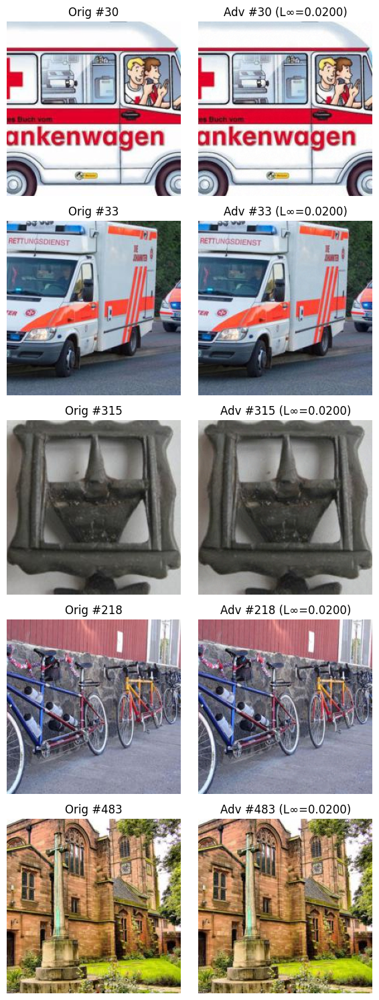

100%|██████████| 8/8 [00:00<00:00, 17.88it/s]


✔️ All 500 adversarial samples respect L∞ ≤ 0.02


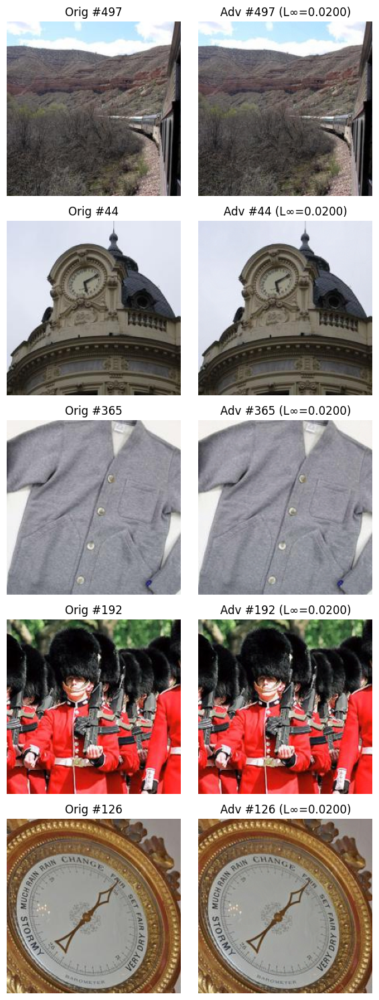

100%|██████████| 8/8 [00:00<00:00, 17.88it/s]


⚠️ Some images exceed ε=0.02% max observed 1.0000 for path: adv_test_set3.pt


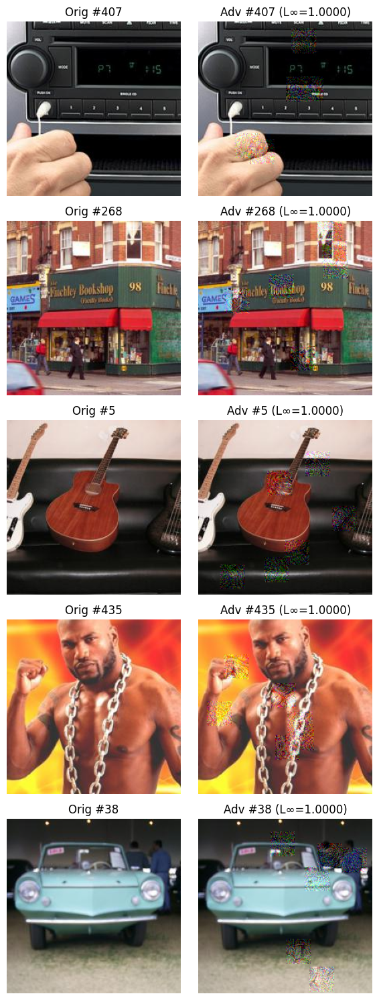

100%|██████████| 8/8 [00:00<00:00, 18.36it/s]


⚠️ Some images exceed ε=0.02% max observed 0.5000 for path: adv_test_set4.pt


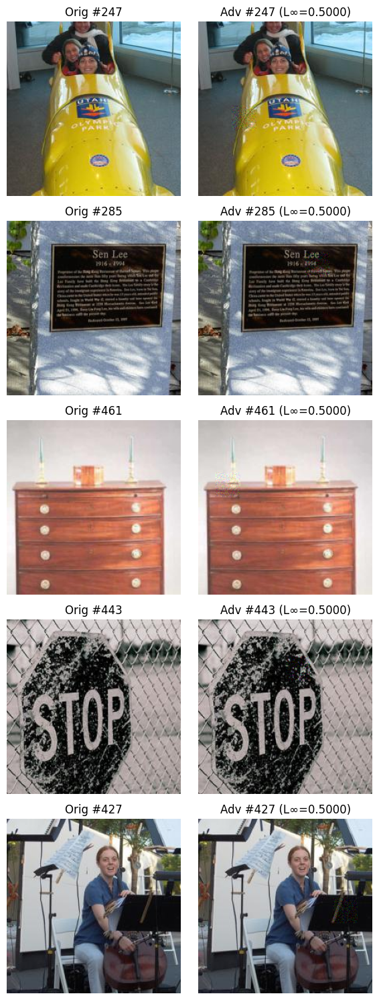

100%|██████████| 8/8 [00:00<00:00, 17.93it/s]


⚠️ Some images exceed ε=0.02% max observed 0.3000 for path: adv_test_set5.pt


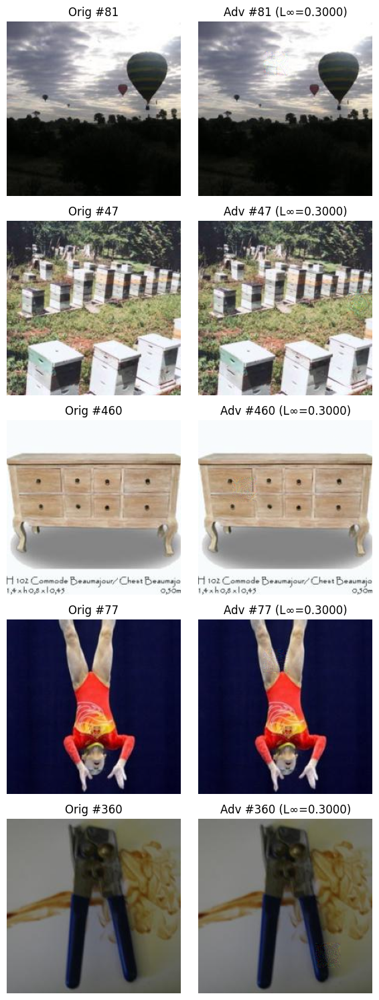

100%|██████████| 8/8 [00:00<00:00, 17.54it/s]


⚠️ Some images exceed ε=0.02% max observed 0.5000 for path: adv_test_set3_A_multi.pt


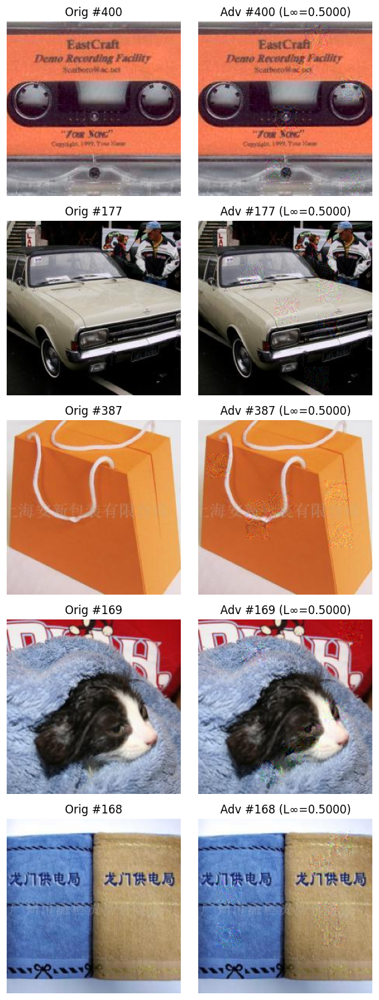

100%|██████████| 8/8 [00:00<00:00, 18.80it/s]


⚠️ Some images exceed ε=0.02% max observed 0.5000 for path: adv_test_set3_B_multi.pt


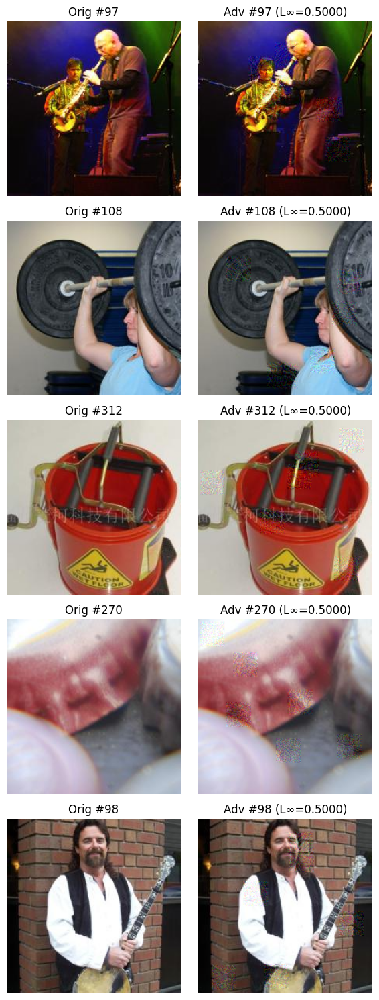


=== A_multi → building 500 adv samples ===
Fixed target for A_multi: 442


Building A_multi: 100%|██████████| 8/8 [02:29<00:00, 18.71s/it]


✅ Saved adv_test_set3_A_multi.pt


Eval: 100%|██████████| 8/8 [00:00<00:00, 22.32it/s]


A_multi → Top-1: 33.60% | Top-5: 67.20%


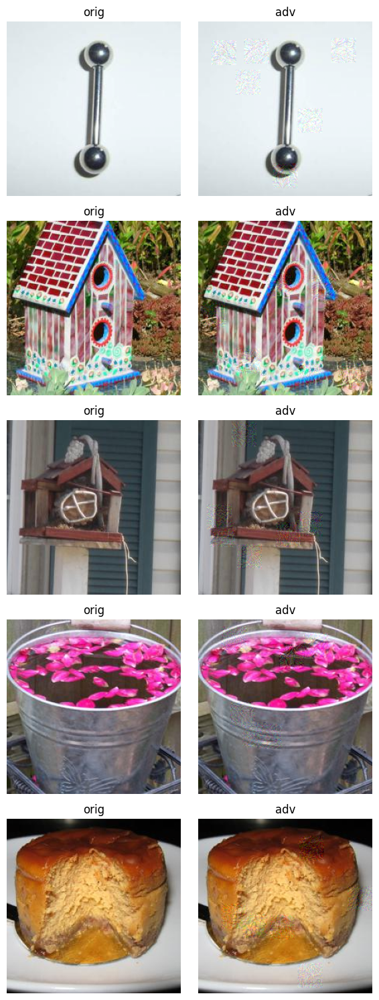


=== B_multi → building 500 adv samples ===


Building B_multi: 100%|██████████| 8/8 [02:29<00:00, 18.71s/it]


✅ Saved adv_test_set3_B_multi.pt


Eval: 100%|██████████| 8/8 [00:00<00:00, 23.39it/s]


B_multi → Top-1: 35.00% | Top-5: 68.80%


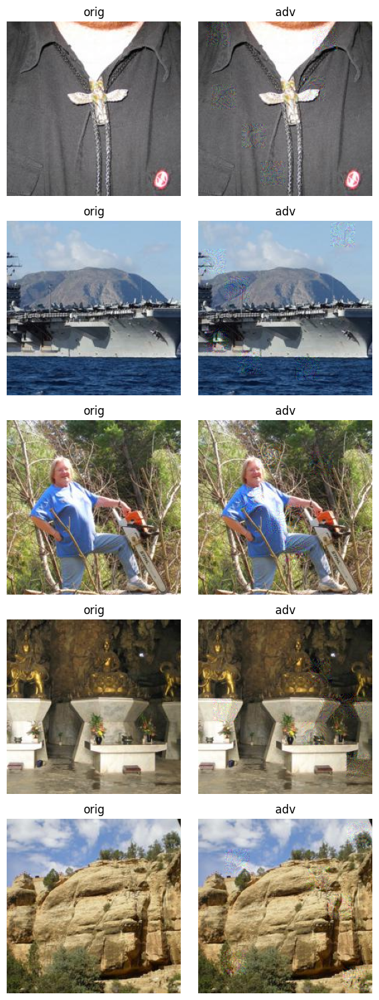

In [39]:
import torch
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
from tqdm import tqdm
import random
import matplotlib.pyplot as plt

# ─── Helpers ──────────────────────────────────────────────────────────────────

def multi_patch_mask(batch_size, H, W, patch_size, num_patches, device):
    mask = torch.zeros(batch_size, 1, H, W, device=device)
    for i in range(batch_size):
        for _ in range(num_patches):
            top  = torch.randint(0, H - patch_size + 1, (1,), device=device).item()
            left = torch.randint(0, W - patch_size + 1, (1,), device=device).item()
            mask[i, :, top:top+patch_size, left:left+patch_size] = 1.0
    return mask

def clamp_norm(x, mean, std):
    mean_t = torch.tensor(mean, device=x.device)[:,None,None]
    std_t  = torch.tensor(std,  device=x.device)[:,None,None]
    min_v = (0.0 - mean_t) / std_t
    max_v = (1.0 - mean_t) / std_t
    return torch.max(torch.min(x, max_v), min_v)

# ─── Variant A+: Multiple Patches, Single Fixed Target ────────────────────────

def attack_A_multi(
    x, target_class, model,
    patch_size=32, num_patches=6,
    eps=0.5, alpha=0.05, iters=40, restarts=8, momentum=0.9,
    mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225), device='cuda'
):
    model.eval()
    b, c, H, W = x.shape
    x_nat = x.to(device)
    targets = torch.full((b,), target_class, device=device, dtype=torch.long)

    best_adv  = x_nat.clone()
    best_loss = torch.full((b,), float('inf'), device=device)

    for _ in range(restarts):
        delta = torch.zeros_like(x_nat).uniform_(-eps, eps).to(device).requires_grad_(True)
        v     = torch.zeros_like(delta)

        for _ in range(iters):
            mask   = multi_patch_mask(b, H, W, patch_size, num_patches, device)
            adv    = clamp_norm(x_nat + delta*mask, mean, std)
            logits = model(adv)
            loss   = F.cross_entropy(logits, targets, reduction='sum')
            grads  = torch.autograd.grad(loss, delta)[0]

            # normalize + momentum
            denom  = grads.abs().view(b,-1).mean(dim=1).view(b,1,1,1).clamp(min=1e-8)
            g_norm = grads / denom
            v      = momentum*v + g_norm

            delta.data = (delta - alpha * v.sign() * mask).clamp(-eps, eps)
            delta.grad = None

        with torch.no_grad():
            final = clamp_norm(x_nat + delta*mask, mean, std)
            losses = F.cross_entropy(model(final), targets, reduction='none')
            better = losses < best_loss
            best_loss[better] = losses[better]
            best_adv[better]  = final[better]

    return best_adv.detach()

# ─── Variant B+: Multiple Patches, Target Subset [401–500] ──────────────────

def attack_B_multi(
    x, model,
    patch_size=32, num_patches=6,
    eps=0.5, alpha=0.05, iters=40, restarts=8, momentum=0.9,
    mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225), device='cuda'
):
    model.eval()
    b, c, H, W = x.shape
    x_nat = x.to(device)

    with torch.no_grad():
        logits0 = model(x_nat)
        subset  = logits0[:, 400:500]            # classes 401–500
        rel_idx = subset.argmin(dim=1)           # 0–99
        targets = rel_idx + 400                  # map → [401–500]

    best_adv  = x_nat.clone()
    best_loss = torch.full((b,), float('inf'), device=device)

    for _ in range(restarts):
        delta = torch.zeros_like(x_nat).uniform_(-eps, eps).to(device).requires_grad_(True)
        v     = torch.zeros_like(delta)

        for _ in range(iters):
            mask   = multi_patch_mask(b, H, W, patch_size, num_patches, device)
            adv    = clamp_norm(x_nat + delta*mask, mean, std)
            logits = model(adv)
            loss   = F.cross_entropy(logits, targets, reduction='sum')
            grads  = torch.autograd.grad(loss, delta)[0]

            denom  = grads.abs().view(b,-1).mean(dim=1).view(b,1,1,1).clamp(min=1e-8)
            g_norm = grads / denom
            v      = momentum*v + g_norm

            delta.data = (delta - alpha * v.sign() * mask).clamp(-eps, eps)
            delta.grad = None

        with torch.no_grad():
            final = clamp_norm(x_nat + delta*mask, mean, std)
            losses = F.cross_entropy(model(final), targets, reduction='none')
            better = losses < best_loss
            best_loss[better] = losses[better]
            best_adv[better]  = final[better]

    return best_adv.detach()

# ─── Build & Evaluate Both Upgraded Variants ─────────────────────────────────

for variant, fn in [
    ("A_multi", lambda x,y: attack_A_multi(x, target, model)),
    ("B_multi", lambda x,y: attack_B_multi(x, model))
]:
    print(f"\n=== {variant} → building 500 adv samples ===")
    if variant == "A_multi":
        target = random.randint(401,500)
        print("Fixed target for A_multi:", target)

    adv_imgs, adv_labels = [], []
    need, count = 500, 0

    for imgs, labels in tqdm(loader, desc=f"Building {variant}"):
        if count >= need: break
        need_n = min(imgs.size(0), need-count)
        batch  = imgs[:need_n]
        adv_b  = fn(batch, None).cpu()
        adv_imgs.append(adv_b)
        adv_labels.append(labels[:need_n])
        count += need_n

    adv_imgs = torch.cat(adv_imgs)
    adv_labels = torch.cat(adv_labels)
    fname = f"adv_test_set3_{variant}.pt"
    torch.save((adv_imgs, adv_labels), fname)
    print("✅ Saved", fname)

    # Evaluate
    ds = TensorDataset(adv_imgs, adv_labels)
    ld = DataLoader(ds, batch_size=64, shuffle=False, num_workers=4)
    torch.save(ld, f"adv_test_set3_{variant}.ld")
    acc1, acc5 = evaluate(ld, model, ks=(1,5))[1], evaluate(ld, model, ks=(1,5))[5]
    print(f"{variant} → Top-1: {acc1*100:.2f}% | Top-5: {acc5*100:.2f}%")

    # Visualize a few
    inv = lambda x: x.mul(torch.tensor(std)[:,None,None]).add_(torch.tensor(mean)[:,None,None])
    idxs = random.sample(range(500), 5)
    fig, ax = plt.subplots(5,2,figsize=(6,15))
    for i, idx in enumerate(idxs):
        orig = inv(loader.dataset[idx][0]).permute(1,2,0).clamp(0,1).numpy()
        adv  = inv(adv_imgs[idx]).permute(1,2,0).clamp(0,1).numpy()
        ax[i,0].imshow(orig); ax[i,0].axis('off'); ax[i,0].set_title("orig")
        ax[i,1].imshow(adv);  ax[i,1].axis('off');  ax[i,1].set_title("adv")
    plt.tight_layout()
    plt.show()

In [40]:
import torch
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
from tqdm import tqdm
import random

# ─── Shared Helpers ──────────────────────────────────────────────────────────

def multi_patch_mask(b, H, W, patch_size, num_patches, device):
    mask = torch.zeros(b, 1, H, W, device=device)
    for i in range(b):
        for _ in range(num_patches):
            t = torch.randint(0, H-patch_size+1, (1,), device=device).item()
            l = torch.randint(0, W-patch_size+1, (1,), device=device).item()
            mask[i, :, t:t+patch_size, l:l+patch_size] = 1.0
    return mask

def clamp_norm(x, mean, std):
    mean_t = torch.tensor(mean, device=x.device)[:,None,None]
    std_t  = torch.tensor(std,  device=x.device)[:,None,None]
    min_v = (0.0 - mean_t) / std_t
    max_v = (1.0 - mean_t) / std_t
    return torch.max(torch.min(x, max_v), min_v)

# ─── Variant C1: Single Fixed Target ───────────────────────

def attack_C1(
    x, target_class, model,
    patch_size=32, num_patches=10,
    eps=1.0, alpha=0.1, iters=100, restarts=10, momentum=0.9,
    mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225), device='cuda'
):
    model.eval()
    b, c, H, W = x.shape
    x_nat = x.to(device)
    targets = torch.full((b,), target_class, device=device, dtype=torch.long)

    best_adv  = x_nat.clone()
    best_loss = torch.full((b,), float('inf'), device=device)

    for _ in range(restarts):
        delta = torch.zeros_like(x_nat).uniform_(-eps, eps).to(device).requires_grad_(True)
        v     = torch.zeros_like(delta)
        for _ in range(iters):
            mask   = multi_patch_mask(b, H, W, patch_size, num_patches, device)
            adv    = clamp_norm(x_nat + delta*mask, mean, std)
            logits = model(adv)
            loss   = F.cross_entropy(logits, targets, reduction='sum')
            grads  = torch.autograd.grad(loss, delta)[0]

            denom  = grads.abs().view(b,-1).mean(dim=1).view(b,1,1,1).clamp(min=1e-8)
            g_norm = grads / denom
            v      = momentum*v + g_norm
            delta.data = (delta - alpha * v.sign() * mask).clamp(-eps, eps)
            delta.grad = None

        with torch.no_grad():
            final = clamp_norm(x_nat + delta*mask, mean, std)
            losses = F.cross_entropy(model(final), targets, reduction='none')
            better = losses < best_loss
            best_loss[better] = losses[better]
            best_adv[better]  = final[better]

    return best_adv.detach()

# ─── Variant C2: Subset Target [401–500] ──────────────────

def attack_C2(
    x, model,
    patch_size=32, num_patches=10,
    eps=1.0, alpha=0.1, iters=100, restarts=10, momentum=0.9,
    mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225), device='cuda'
):
    model.eval()
    b, c, H, W = x.shape
    x_nat = x.to(device)

    with torch.no_grad():
        logits0 = model(x_nat)
        subset  = logits0[:, 400:500]
        rel_idx = subset.argmin(dim=1)
        targets = rel_idx + 400

    best_adv  = x_nat.clone()
    best_loss = torch.full((b,), float('inf'), device=device)

    for _ in range(restarts):
        delta = torch.zeros_like(x_nat).uniform_(-eps, eps).to(device).requires_grad_(True)
        v     = torch.zeros_like(delta)
        for _ in range(iters):
            mask   = multi_patch_mask(b, H, W, patch_size, num_patches, device)
            adv    = clamp_norm(x_nat + delta*mask, mean, std)
            logits = model(adv)
            loss   = F.cross_entropy(logits, targets, reduction='sum')
            grads  = torch.autograd.grad(loss, delta)[0]

            denom  = grads.abs().view(b,-1).mean(dim=1).view(b,1,1,1).clamp(min=1e-8)
            g_norm = grads / denom
            v      = momentum*v + g_norm
            delta.data = (delta - alpha * v.sign() * mask).clamp(-eps, eps)
            delta.grad = None

        with torch.no_grad():
            final = clamp_norm(x_nat + delta*mask, mean, std)
            losses = F.cross_entropy(model(final), targets, reduction='none')
            better = losses < best_loss
            best_loss[better] = losses[better]
            best_adv[better]  = final[better]

    return best_adv.detach()

# ─── Build & Evaluate Variant C1 and C2 ────────────────────────────────────

for name, fn in [("C1_single", attack_C1), ("C2_subset", attack_C2)]:
    print(f"\n=== Running {name} ===")
    if name == "C1_single":
        target = random.randint(401, 500)
        print("Fixed target class:", target)

    adv_imgs, adv_labels = [], []
    need, count = 500, 0

    for imgs, labels in tqdm(loader, desc=f"Building {name}"):
        if count >= need: break
        n = min(imgs.size(0), need - count)
        batch = imgs[:n]
        adv_b = (fn(batch, target, model) if name=="C1_single" else fn(batch, model)).cpu()
        adv_imgs.append(adv_b)
        adv_labels.append(labels[:n])
        count += n

    adv_imgs   = torch.cat(adv_imgs)
    adv_labels = torch.cat(adv_labels)
    fname = f"adv_test_set3_{name}.pt"
    torch.save((adv_imgs, adv_labels), fname)
    print("Saved", fname)

    ds = TensorDataset(adv_imgs, adv_labels)
    ld = DataLoader(ds, batch_size=64, shuffle=False, num_workers=4)
    torch.save(ld, f"adv_test_set3_{name}.ld")
    acc1, acc5 = evaluate(ld, model, ks=(1,5))[1], evaluate(ld, model, ks=(1,5))[5]
    print(f"{name} → Top-1: {acc1*100:.2f}% | Top-5: {acc5*100:.2f}%")


=== Running C1_single ===
Fixed target class: 486


Building C1_single: 100%|██████████| 8/8 [10:29<00:00, 78.67s/it]


Saved adv_test_set3_C1_single.pt


Eval: 100%|██████████| 8/8 [00:00<00:00, 23.74it/s]


C1_single → Top-1: 1.80% | Top-5: 19.60%

=== Running C2_subset ===


Building C2_subset: 100%|██████████| 8/8 [10:28<00:00, 78.59s/it]


Saved adv_test_set3_C2_subset.pt


Eval: 100%|██████████| 8/8 [00:00<00:00, 22.57it/s]

C2_subset → Top-1: 1.00% | Top-5: 4.80%


100%|██████████| 8/8 [00:00<00:00, 16.74it/s]


✔️ All 500 adversarial samples respect L∞ ≤ 0.02


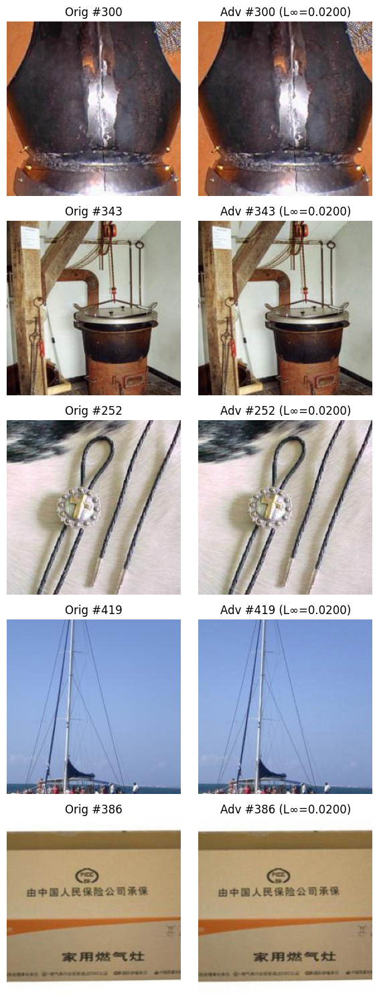

100%|██████████| 8/8 [00:00<00:00, 16.51it/s]


✔️ All 500 adversarial samples respect L∞ ≤ 0.02


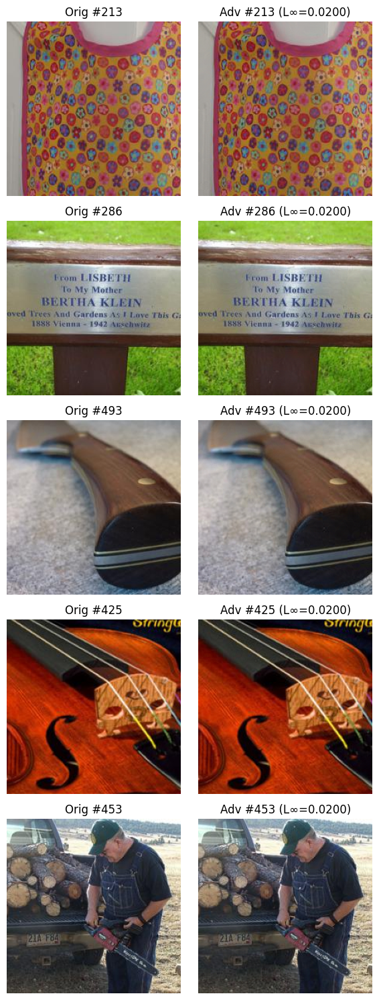

100%|██████████| 8/8 [00:00<00:00, 17.17it/s]


⚠️ Some images exceed ε=0.02% max observed 1.0000 for path: adv_test_set3.pt


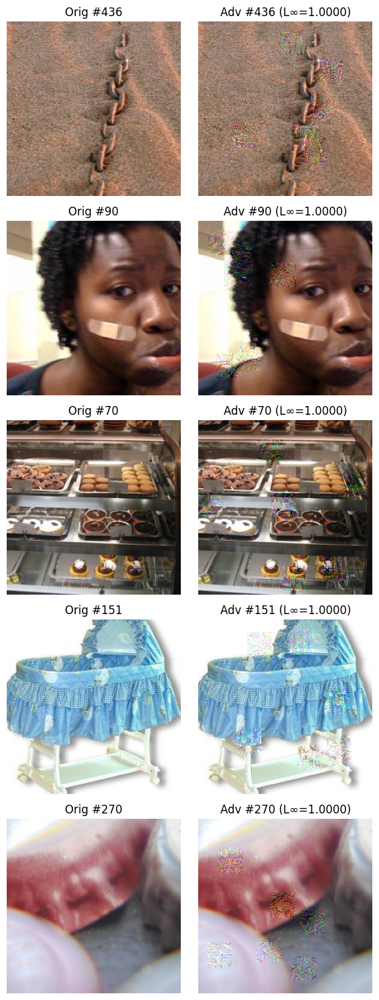

100%|██████████| 8/8 [00:00<00:00, 16.72it/s]


⚠️ Some images exceed ε=0.02% max observed 0.5000 for path: adv_test_set4.pt


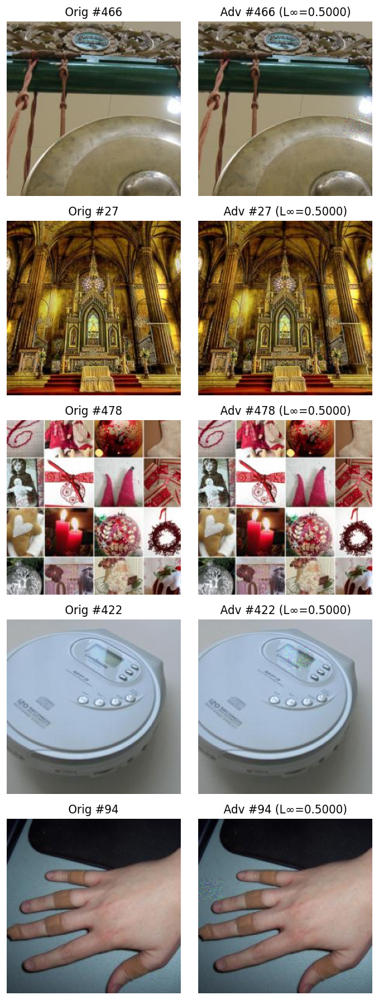

100%|██████████| 8/8 [00:00<00:00, 16.59it/s]


⚠️ Some images exceed ε=0.02% max observed 0.3000 for path: adv_test_set5.pt


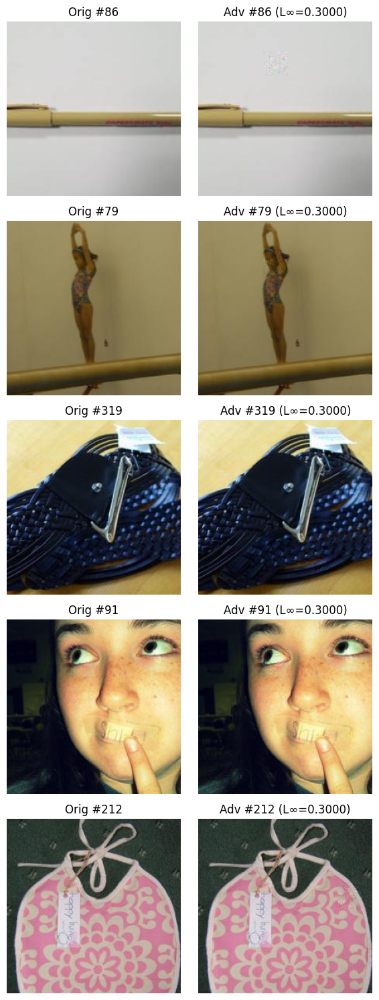

100%|██████████| 8/8 [00:00<00:00, 16.80it/s]


⚠️ Some images exceed ε=0.02% max observed 0.5000 for path: adv_test_set3_A_multi.pt


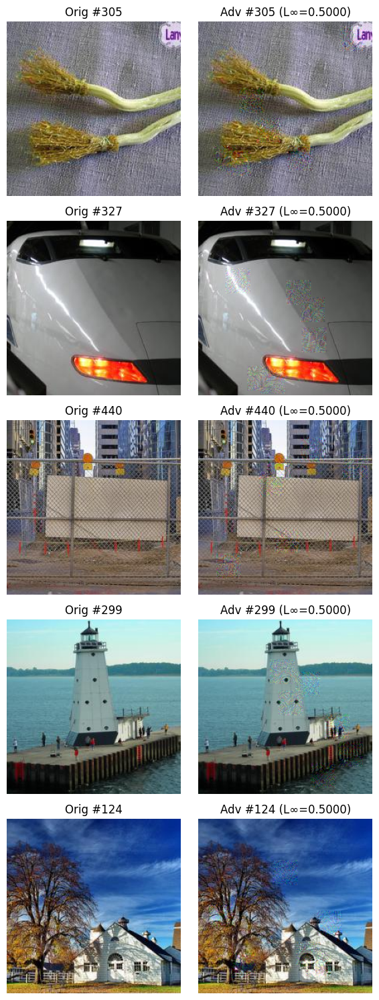

100%|██████████| 8/8 [00:00<00:00, 16.51it/s]


⚠️ Some images exceed ε=0.02% max observed 0.5000 for path: adv_test_set3_B_multi.pt


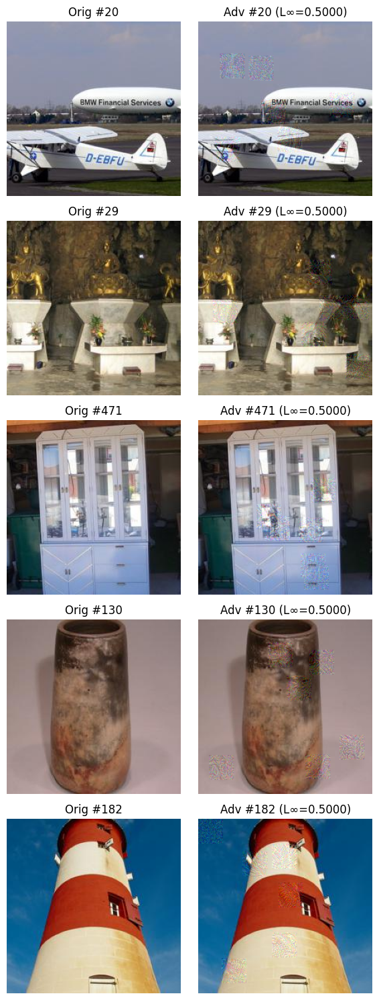

100%|██████████| 8/8 [00:00<00:00, 16.71it/s]


⚠️ Some images exceed ε=0.02% max observed 1.0000 for path: adv_test_set3_C1_single.pt


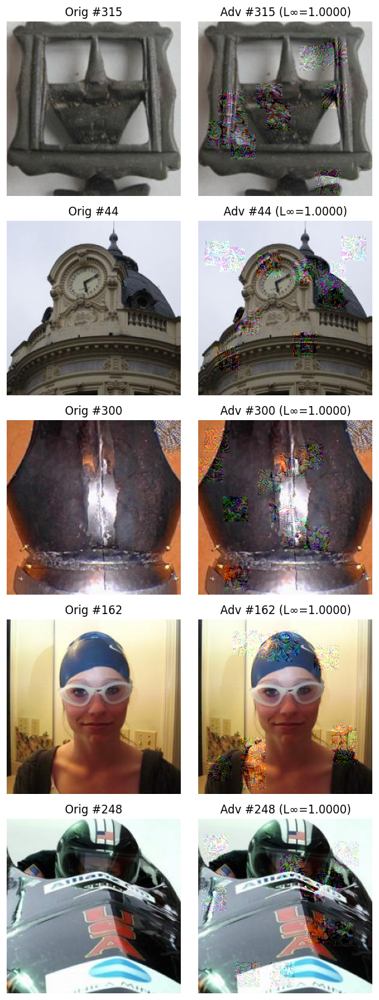

100%|██████████| 8/8 [00:00<00:00, 16.17it/s]


⚠️ Some images exceed ε=0.02% max observed 1.0000 for path: adv_test_set3_C2_subset.pt


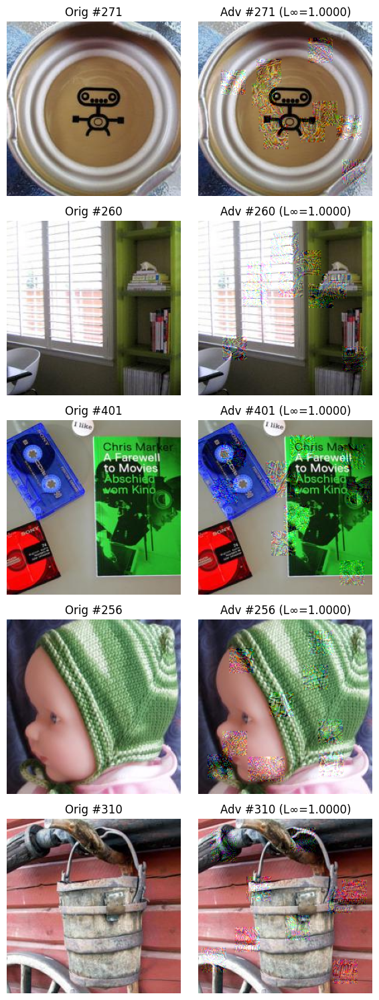

In [41]:
path_list = ['adv_test_set1.pt','adv_test_set2.pt','adv_test_set3.pt','adv_test_set4.pt','adv_test_set5.pt', 'adv_test_set3_A_multi.pt','adv_test_set3_B_multi.pt', 'adv_test_set3_C1_single.pt', 'adv_test_set3_C2_subset.pt' ]
for path in path_list:
    verify_L_inf(path, loader)

In [47]:
transfer_model = torchvision.models.densenet121(
    weights=torchvision.models.DenseNet121_Weights.IMAGENET1K_V1
).eval().to(device)

adv6_loader = torch.load("adv_test_set3_A_multi.ld", weights_only=False)
adv7_loader = torch.load("adv_test_set3_B_multi.ld", weights_only=False)
adv8_loader = torch.load("adv_test_set3_C1_single.ld", weights_only=False)
adv9_loader = torch.load("adv_test_set3_C2_subset.ld", weights_only=False)
for name, ldr in [
    ("Original" , loader),
    ("FGSM"     , adv_loader),
    ("PGD"      , adv2_loader),
    ("Multipatch", adv3_loader),
    ("Targeted Patch", adv4_loader),
    ("Patch", adv5_loader),
    ("Multiple Patches, Single Fixed Target", adv6_loader), 
    ("Multiple Patches, Target Subset [401–500]", adv7_loader),
    ("Variant C1: Single Fixed Target", adv8_loader),
    ("Variant C2: Subset Target [401–500]", adv9_loader)
]:
    acc_1 = evaluate(ldr, model, ks=(1,5))
    acc = evaluate(ldr, transfer_model, ks=(1,5))
    print("\nEvaluation on ResNet34\n")
    print(f"{name:8} → Top‑1: {acc_1[1]*100:5.2f}%, Top‑5: {acc_1[5]*100:5.2f}%")
    print("\nTransfer to DenseNet121\n")
    print(f"{name:8} → Top‑1: {acc[1]*100:5.2f}%, Top‑5: {acc[5]*100:5.2f}%")

Eval: 100%|██████████| 8/8 [00:00<00:00, 11.58it/s]



Evaluation on ResNet34

Original → Top‑1: 76.00%, Top‑5: 94.20%

Transfer to DenseNet121

Original → Top‑1: 74.60%, Top‑5: 93.60%


Eval: 100%|██████████| 8/8 [00:00<00:00, 15.45it/s]



Evaluation on ResNet34

FGSM     → Top‑1:  6.00%, Top‑5: 35.60%

Transfer to DenseNet121

FGSM     → Top‑1: 63.60%, Top‑5: 89.40%


Eval: 100%|██████████| 8/8 [00:00<00:00, 15.95it/s]



Evaluation on ResNet34

PGD      → Top‑1:  0.00%, Top‑5: 11.60%

Transfer to DenseNet121

PGD      → Top‑1: 64.00%, Top‑5: 91.20%


Eval: 100%|██████████| 8/8 [00:00<00:00, 15.63it/s]



Evaluation on ResNet34

Multipatch → Top‑1: 19.40%, Top‑5: 45.00%

Transfer to DenseNet121

Multipatch → Top‑1: 63.00%, Top‑5: 84.60%


Eval: 100%|██████████| 8/8 [00:00<00:00, 15.96it/s]



Evaluation on ResNet34

Targeted Patch → Top‑1: 73.80%, Top‑5: 94.60%

Transfer to DenseNet121

Targeted Patch → Top‑1: 74.00%, Top‑5: 93.00%


Eval: 100%|██████████| 8/8 [00:00<00:00, 15.67it/s]



Evaluation on ResNet34

Patch    → Top‑1: 45.20%, Top‑5: 80.20%

Transfer to DenseNet121

Patch    → Top‑1: 71.80%, Top‑5: 92.60%


Eval: 100%|██████████| 8/8 [00:00<00:00, 15.62it/s]



Evaluation on ResNet34

Multiple Patches, Single Fixed Target → Top‑1: 33.60%, Top‑5: 67.20%

Transfer to DenseNet121

Multiple Patches, Single Fixed Target → Top‑1: 70.60%, Top‑5: 90.40%


Eval: 100%|██████████| 8/8 [00:00<00:00, 15.35it/s]



Evaluation on ResNet34

Multiple Patches, Target Subset [401–500] → Top‑1: 35.00%, Top‑5: 68.80%

Transfer to DenseNet121

Multiple Patches, Target Subset [401–500] → Top‑1: 69.60%, Top‑5: 90.40%


Eval: 100%|██████████| 8/8 [00:00<00:00, 15.82it/s]



Evaluation on ResNet34

Variant C1: Single Fixed Target → Top‑1:  1.80%, Top‑5: 19.60%

Transfer to DenseNet121

Variant C1: Single Fixed Target → Top‑1: 56.80%, Top‑5: 80.20%


Eval: 100%|██████████| 8/8 [00:00<00:00, 15.64it/s]


Evaluation on ResNet34

Variant C2: Subset Target [401–500] → Top‑1:  1.00%, Top‑5:  4.80%

Transfer to DenseNet121

Variant C2: Subset Target [401–500] → Top‑1: 54.80%, Top‑5: 78.60%
